In [30]:
# File is intended to run on the UIUC Campus Cluster (CAPs).
# You can specify the galaxies you want to run

# In terminal:
#     To run all galaxies:        ~$ python3 Restart_Emcee_Step.py all
#     To run galaxies 1, 6:       ~$ python3 Restart_Emcee_Step.py 1 6 

# 1:    ### Import packages ### ----------------------------------------------------------------------------
# import standard python packages
import time, sys, os
import numpy as np
import astropy as ap
from matplotlib.pyplot import *
import seaborn as sns

# Import packages to open fits and calculate cosmology
from astropy.io import fits
from astropy.cosmology import WMAP9
import astropy.coordinates as coord
from astropy.coordinates import SkyCoord
from astropy import units as u
from astroquery.sdss import SDSS
from scipy.io import readsav

# Import prospector 
sys.path.insert(0, '/mnt/c/Users/emma_d/ASTR_Research/lib/python3.8/site-packages/repo/prospector/')
import prospect     
from prospect.fitting import fit_model
from prospect.io import write_results as writer
from prospect.plotting import corner
from functools import partial
import prospect.io.read_results as reader

from prospect.io.read_results import emcee_restarter #New
from prospect.fitting import restart_emcee_sampler
import h5py

import emcee
# import dynesty

# Import my build functions
from build_model_funct import build_model
from build_obs_funct import build_obs

from prospect.sources.ssp_basis import FastStepBasis as FracSFH
# from FracSFH_ import FracSFH

# re-defining plotting defaults for matplotlib
from matplotlib.font_manager import FontProperties
from matplotlib import gridspec
my_cmap = sns.color_palette("tab10")
rcParams.update({'xtick.major.pad': '7.0'})
rcParams.update({'xtick.major.size': '7.5'})
rcParams.update({'xtick.major.width': '1.5'})
rcParams.update({'xtick.minor.pad': '7.0'})
rcParams.update({'xtick.minor.size': '3.5'})
rcParams.update({'xtick.minor.width': '1.0'})
rcParams.update({'ytick.major.pad': '7.0'})
rcParams.update({'ytick.major.size': '7.5'})
rcParams.update({'ytick.major.width': '1.5'})
rcParams.update({'ytick.minor.pad': '7.0'})
rcParams.update({'ytick.minor.size': '3.5'})
rcParams.update({'ytick.minor.width': '1.0'})
rcParams.update({'xtick.color': 'k'})
rcParams.update({'ytick.color': 'k'})
rcParams.update({'font.size': 30})
rcParams.update({'axes.facecolor':'w'})
rcParams.update({'savefig.facecolor':'w'})
rcParams.update({'lines.linewidth':'0.7'})
rcParams.update({'axes.prop_cycle': cycler(color = sns.color_palette("tab10"))})
rcParams.update({'figure.dpi': 300})
rcParams.update({'savefig.dpi': 300})

# Turn off warnings to clear up terminal when running
import warnings
warnings.filterwarnings('ignore', message='.*encountered in log.*')
warnings.filterwarnings('ignore', message='.*Reading unicode strings without specifying.*')
warnings.filterwarnings('ignore', message='.*Invalid keyword for column 66.*')
warnings.filterwarnings('ignore', message='.*Could not store paramfile text.*')
warnings.filterwarnings('ignore', message='.*Could not JSON serialize.*')
np.warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)
# np.seterr(all="ignore")

ModuleNotFoundError: No module named 'dynesty'

In [2]:
CAPS = False

if CAPS == False:
    AGN_FITS_PATH = '/mnt/c/Users/emma_d/ASTR_Research/Data/asu.fit'
    G_PATH = 'Galaxy_output/CAPS_Output'
    IRS_PATH = 'Data/ea_struct_v9.sav'
    Z_PATH = 'Data/G_Redshift.csv'
elif CAPS == True:
    AGN_FITS_PATH = '/home/elitzer3/scratch/PSB_AGN_Scratch/Data/asu.fit'
    G_PATH = '/home/elitzer3/scratch/PSB_AGN_Scratch/Galaxy_output'
    IRS_PATH = '/home/elitzer3/scratch/PSB_AGN_Scratch/Data/ea_struct_v9.sav'
    Z_PATH = '/home/elitzer3/scratch/PSB_AGN_Scratch/Data/G_Redshift.csv'
else:
    print('Please set CAPS to True for running on CAPS or False for running on personal machine.')

print('{0}: Packages and Functions Loaded'.format(time.strftime("%H:%M:%S", time.localtime())))

23:36:26: Packages and Functions Loaded


In [3]:
# 2:    ### Define constants and functions ### ------------------------------------------------------------- 
# Constants:
lsun = 3.846e33
pc = 3.085677581467192e18                   # in cm
lightspeed = 2.998e18                       # A/s
to_cgs = lsun/(4.0 * np.pi * (pc*10)**2)
jansky_mks = 1e-26

# My Unit Functions:
def mJy_to_maggies(mJy):
    """ Converts mJy to maggies
    """
    conversion_mJy_Jy = .001
    conversion_mJy_maggie = 3631
    return mJy * conversion_mJy_Jy/conversion_mJy_maggie

def f_nu_to_f_lambda_maggie(lam, f_nu):
    """ Converts f_nu (ergs) to f_lambda (maggies)
    """
    f_lambda_ergs = (10**-17 * f_nu) * (lam**2)/lightspeed
    f_lambda_mJy = (f_lambda_ergs / (1E-23)) * 1000
    f_lambda_maggie = mJy_to_maggies(f_lambda_mJy)
    return f_lambda_maggie

# From GitHub:
def get_best_v2(res, **kwargs):
    """ Get the maximum a posteriori parameters.
    """
    imax = np.argmax(res['lnprobability'])
    try:
        i, j = np.unravel_index(imax, res['lnprobability'].shape)
        theta = res['chain'][i, j, :].copy()
    except(ValueError):
        theta = res['chain'][imax, :].copy()
        
    return  theta

def build_sps(zcontinuous=1, **extras):
    """ Build sps object using FracSFH basis
    """
    sps = FracSFH(zcontinuous = 1, **extras)        
    return sps

def zfrac_to_masses(total_mass=None, z_fraction=None, agebins=None, **extras):
    """This transforms from independent dimensionless `z` variables to sfr
    fractions and then to bin mass fractions. The transformation is such that
    sfr fractions are drawn from a Dirichlet prior.  See Betancourt et al. 2010
    and Leja et al. 2017
    :param total_mass:
        The total mass formed over all bins in the SFH.
    :param z_fraction:
        latent variables drawn form a specific set of Beta distributions. (see
        Betancourt 2010)
    :returns masses:
        The stellar mass formed in each age bin.
    """
    # sfr fractions
    sfr_fraction = np.zeros(len(z_fraction) + 1)
    sfr_fraction[0] = 1.0 - z_fraction[0]
    for i in range(1, len(z_fraction)):
        sfr_fraction[i] = np.prod(z_fraction[:i]) * (1.0 - z_fraction[i])
    sfr_fraction[-1] = 1 - np.sum(sfr_fraction[:-1])

    # convert to mass fractions
    time_per_bin = np.diff(10**agebins, axis=-1)[:, 0]
    mass_fraction = sfr_fraction * np.array(time_per_bin)
    mass_fraction /= mass_fraction.sum()

    masses = total_mass * mass_fraction
    return masses

def zfrac_to_sfr(total_mass=None, z_fraction=None, agebins=None, **extras):
    """This transforms from independent dimensionless `z` variables to SFRs.
    :returns sfrs:
        The SFR in each age bin (msun/yr).
    """
    time_per_bin = np.diff(10**agebins, axis=-1)[:, 0]
    masses = zfrac_to_masses(total_mass, z_fraction, agebins)
    return masses / time_per_bin

def best_vals(result_list):
    q_16, q_50, q_84 = corner.quantile(result_list, [0.16, 0.5, 0.84]) 
    dx_down, dx_up = q_50-q_16, q_84-q_50
    # return (np.around(q_50,2), np.around(dx_up,2), np.around(dx_down,2))
    return q_50, dx_up, dx_down

def lnprobfn(theta, model=None, obs=None, sps=None, noise=(None, None),
             residuals=False, nested=False, verbose=False):
    """Given a parameter vector and optionally a dictionary of observational
    ata and a model object, return the matural log of the posterior. This
    requires that an sps object (and if using spectra and gaussian processes, a
    NoiseModel) be instantiated.

    :param theta:
        Input parameter vector, ndarray of shape (ndim,)

    :param model:
        SedModel model object, with attributes including ``params``, a
        dictionary of model parameter state.  It must also have
        :py:func:`prior_product`, and :py:func:`predict` methods
        defined.

    :param obs:
        A dictionary of observational data.  The keys should be
          + ``"wavelength"``  (angstroms)
          + ``"spectrum"``    (maggies)
          + ``"unc"``         (maggies)
          + ``"maggies"``     (photometry in maggies)
          + ``"maggies_unc"`` (photometry uncertainty in maggies)
          + ``"filters"``     (iterable of :py:class:`sedpy.observate.Filter`)
          +  and optional spectroscopic ``"mask"`` and ``"phot_mask"``
             (same length as ``spectrum`` and ``maggies`` respectively,
             True means use the data points)

    :param sps:
        A :py:class:`prospect.sources.SSPBasis` object or subclass thereof, or
        any object with a ``get_spectrum`` method that will take a dictionary
        of model parameters and return a spectrum, photometry, and ancillary
        information.

    :param noise: (optional, default: (None, None))
        A 2-element tuple of :py:class:`prospect.likelihood.NoiseModel` objects.

    :param residuals: (optional, default: False)
        A switch to allow vectors of :math:`\chi` values to be returned instead
        of a scalar posterior probability.  This can be useful for
        least-squares optimization methods. Note that prior probabilities are
        not included in this calculation.

    :param nested: (optional, default: False)
        If ``True``, do not add the ln-prior probability to the ln-likelihood
        when computing the ln-posterior.  For nested sampling algorithms the
        prior probability is incorporated in the way samples are drawn, so
        should not be included here.

    :returns lnp:
        Ln posterior probability, unless ``residuals=True`` in which case a
        vector of :math:`\chi` values is returned.
    """
    if residuals:
        lnnull = np.zeros(obs["ndof"]) - 1e18  # np.infty
        #lnnull = -np.infty
    else:
        lnnull = -np.infty

    # --- Calculate prior probability and exit if not within prior ---
    lnp_prior = model.prior_product(theta, nested=nested)
    if not np.isfinite(lnp_prior):
        return lnnull

    #  --- Update Noise Model ---
    spec_noise, phot_noise = noise
    vectors, sigma_spec = {}, None
    model.set_parameters(theta)
    if spec_noise is not None:
        spec_noise.update(**model.params)
        vectors.update({"unc": obs.get('unc', None)})
        sigma_spec = spec_noise.construct_covariance(**vectors)
    if phot_noise is not None:
        phot_noise.update(**model.params)
        vectors.update({'phot_unc': obs.get('maggies_unc', None),
                        'phot': obs.get('maggies', None)})

    # --- Generate mean model ---
    try:
        t1 = time.time()
        spec, phot, x = model.predict(theta, obs, sps=sps, sigma_spec=sigma_spec)
        d1 = time.time() - t1
    except(ValueError):
        return lnnull
    except:
        print("There was an error during the likelihood call at parameters {}".format(theta))
        raise

    # --- Optionally return chi vectors for least-squares ---
    # note this does not include priors!
    if residuals:
        chispec = chi_spec(spec, obs)
        chiphot = chi_phot(phot, obs)
        return np.concatenate([chispec, chiphot])

    #  --- Mixture Model ---
    f_outlier_spec = model.params.get('f_outlier_spec', 0.0)
    if (f_outlier_spec != 0.0):
        sigma_outlier_spec = model.params.get('nsigma_outlier_spec', 10)
        vectors.update({'nsigma_outlier_spec': sigma_outlier_spec})
    f_outlier_phot = model.params.get('f_outlier_phot', 0.0)
    if (f_outlier_phot != 0.0):
        sigma_outlier_phot = model.params.get('nsigma_outlier_phot', 10)
        vectors.update({'nsigma_outlier_phot': sigma_outlier_phot})

    # --- Emission Lines ---

    # --- Calculate likelihoods ---
    t1 = time.time()
    lnp_spec = lnlike_spec(spec, obs=obs,
                           f_outlier_spec=f_outlier_spec,
                           spec_noise=spec_noise,
                           **vectors)
    lnp_phot = lnlike_phot(phot, obs=obs,
                           f_outlier_phot=f_outlier_phot,
                           phot_noise=phot_noise, **vectors)
    lnp_eline = getattr(model, '_ln_eline_penalty', 0.0)

    d2 = time.time() - t1
    if verbose:
        write_log(theta, lnp_prior, lnp_spec, lnp_phot, d1, d2)

    return lnp_prior + lnp_phot + lnp_spec + lnp_eline

In [4]:
def initialize_theta(galaxy_num, Template_Type, ts, AGN_data, gal_desig, Galaxy_Path, Run_Num, Num_Iters): #, input_hfile 
    if Run_Num == 0:
        # 5: ### Pull RA, DEC, z from data file and query SDSS ### -----------------------------------------------------
        Gal_RA, Gal_DEC = AGN_data[galaxy_num][2], AGN_data[galaxy_num][3]
        Gal_z = np.genfromtxt(Z_PATH, delimiter=',', dtype=float)[:,1]
        
        cosmo = ap.cosmology.FlatLambdaCDM(H0=70 , Om0=0.3)         # Cosmological redshift object   
        ldist_Mpc_units = cosmo.comoving_distance(Gal_z)            # Cosmological redshift 

        ldist_Mpc = ldist_Mpc_units.value           
        tage_of_univ = WMAP9.age(Gal_z).value                       # Gyr

        # ---- SDSS --------------------------------------------------------------------------------------------------
        pos = coord.SkyCoord(Gal_RA, Gal_DEC, unit='deg',frame='icrs')
        xid = SDSS.query_region(pos, spectro=True)

        # 6: ### Redefine RA, DEC ### -------------------------------------------------------------------------------
        Gal_RA_SDSS = xid['ra'][0]
        Gal_DEC_SDSS = xid['dec'][0]

        G_Redshift_SDSS = xid['z'][0]                                    # Use redshift from SDSS query
        cosmo_SDSS = ap.cosmology.FlatLambdaCDM(H0=70 , Om0=0.3)         # Cosmological redshift object   
        ldist_Mpc_units_SDSS = cosmo.comoving_distance(G_Redshift_SDSS)  # Cosmological redshift 

        ldist_Mpc_SDSS = ldist_Mpc_units.value           
        tage_of_univ_SDSS = WMAP9.age(G_Redshift_SDSS).value                  # Gyr


        # 7:    ### Get optical image from the url using galaxy RA and DEC ### -------------------------------------
        SDSS_scale = 0.396127                                       # arcsec/pix
        SDSS_width = 128                                            # SDSS_arcsec/SDSS_scale
        SDSS_arcsec = SDSS_width * SDSS_scale                       # arcsec 
        SDSS_deg = SDSS_arcsec/3600                                 # deg

        SDSS_center_coords = SkyCoord(ra=Gal_RA*u.degree, dec=Gal_DEC*u.degree)
        SDSS_left_coords = SkyCoord(ra=Gal_RA*u.degree - (SDSS_deg/2) * u.deg, dec=Gal_DEC*u.degree - (SDSS_deg/2) * u.deg)
        SDSS_right_coords = SkyCoord(ra=Gal_RA*u.degree + (SDSS_deg/2) * u.deg, dec=Gal_DEC*u.degree + (SDSS_deg/2) * u.deg)

        ra_center_str = '{0:.0f}h{1:.0f}m{2:.0f}s'.format(SDSS_center_coords.ra.hms[0], SDSS_center_coords.ra.hms[1], SDSS_center_coords.ra.hms[2])
        ra_left_str = '{0:.0f}h{1:.0f}m{2:.0f}s'.format(SDSS_left_coords.ra.hms[0], SDSS_left_coords.ra.hms[1], SDSS_left_coords.ra.hms[2])
        ra_right_str = '{0:.0f}h{1:.0f}m{2:.0f}s'.format(SDSS_right_coords.ra.hms[0], SDSS_right_coords.ra.hms[1], SDSS_right_coords.ra.hms[2])

        dec_center_str = '{0:.0f}h{1:.0f}m{2:.0f}s'.format(SDSS_center_coords.dec.hms[0], SDSS_center_coords.dec.hms[1], SDSS_center_coords.dec.hms[2])
        dec_left_str = '{0:.0f}h{1:.0f}m{2:.0f}s'.format(SDSS_left_coords.dec.hms[0], SDSS_left_coords.dec.hms[1], SDSS_left_coords.dec.hms[2])
        dec_right_str = '{0:.0f}h{1:.0f}m{2:.0f}s'.format(SDSS_right_coords.dec.hms[0], SDSS_right_coords.dec.hms[1], SDSS_right_coords.dec.hms[2])


        # 8:    ### Retreive IRS Data and indicate if it exists ### -------------------------------------------------
        ea_struct = readsav(IRS_PATH)['ea_struct'] 

        # gal_desig = AGN_data[galaxy_num][1]
        gal_EA_Desig = gal_desig[2:]
        s1, = np.where(ea_struct.source.astype(str) == 'Spitzer')       # Pulls only spitzer from sources
        ea_struct = ea_struct[s1]                                       # Masks ea_struct to get spitzer

        # If the IRS data contains the galaxy, graph the IRS data. If not print there is no IRS data
        if gal_EA_Desig in ea_struct['EA_DESIG'].astype(str):
            IRS_indicator = 1                                           # Indicates there is IRS data
            print('{0}: There is Spitzer IRS spectrum data for this galaxy'.format(time.strftime("%H:%M:%S", time.localtime())))
        else:
            IRS_indicator = 0                                           # Indicates there is no IRS data
            print('{0}: There is no Spitzer IRS spectrum data for this galaxy'.format(time.strftime("%H:%M:%S", time.localtime())))


        # 9:   ### Create run_params dictionary ### -----------------------------------------------------------------
        run_params = { 'ldist': ldist_Mpc,
                        'agelims': [0.0,8.0,8.5,9.0,9.5,9.8,10.0],
                        'object_redshift_SDSS': G_Redshift_SDSS,
                        'object_redshift': Gal_z,
                        'object_coord': [Gal_RA, Gal_DEC],
                        'object_coord_SDSS': [Gal_RA_SDSS, Gal_DEC_SDSS],
                        'logmass_init': AGN_data[galaxy_num][50],   # Msun, not total formed
                        'zcontinuous': 1,                           # Leja: 2
                        'verbose': True,                            # Leja: True, OG: False
                        'dynesty': False,                           
                        'emcee': False,                             
                        'optimize': False,                          
                        'optimization': False,
                        'min_method': 'lm',
                        'nmin': 1,                                  
                        'nwalkers': 620,                            # Leja: 620 #128 #300
                        'niter': 1024,                               # Leja: 7500 # 512
                        'nburn': [16, 32, 64],                      # Leja: [150, 200, 200] # [16, 32, 64] <-- takes ~ 30m
                        'optimization': False,

                        # 'nested_method': 'rwalk',
                        # 'nlive_init': 400,
                        # 'nlive_batch': 200,
                        # 'nested_dlogz_init': 0.05,
                        # 'nested_posterior_thresh': 0.05,
                        # 'nested_maxcall': int(1e7),

                        'interval': 0.2,
                        'nofork': True,

                        # 'convergence_check_interval': 50,
                        'convergence_chunks': 325,
                        'convergence_kl_threshold': 0.016,
                        'convergence_stable_points_criteria': 8, 
                        # 'convergence_nhist': 50,

                        'objname': 'G{0}_{1}'.format(galaxy_num, gal_desig),
                        'initial_disp': 0.1,
                        'AGN_switch': True,
                        'tage_of_univ': tage_of_univ,
                        'Template_Type': Template_Type,
                        'galaxy_num': galaxy_num,
                        'IRS_indicator': IRS_indicator,
                        'SDSS_Query': xid,
                        'total_mass_switch': True,
                        'gal_desig': gal_desig,
                        'ts': ts,
                        'ID': 'G{0}_{1}_{2}'.format(galaxy_num, gal_desig, Template_Type), #_{3} ,ts
                        'ra_labels': [ra_left_str, ra_center_str, ra_right_str],
                        'dec_labels': [dec_left_str, dec_center_str, dec_right_str],
                        'Run_Num': Run_Num
                        }
        
        # 10:   ### Built obs dict using meta-params ### ------------------------------------------------------------
        obs = build_obs(**run_params)

        # 11:   ### Define agelimits, tilde_alpha, and z_fraction_init for build_model ### --------------------------
        # Determine agelimits for SFR
        agelims = run_params['agelims']
        agelims[-1] = np.log10(tage_of_univ * 1e9)
        agelims1, agelims2 = agelims[:-1], agelims[1:]
        agebins = np.array([agelims1, agelims2], dtype='object')
        # print(agebins)
        # agebins = np.array([agelims[:-1], agelims[1:]])

        ncomp = agebins.shape[1]

        tilde_alpha = np.array([ncomp - i for i in list(range(1, ncomp))])
        z_fraction_init = np.array([(i-1)/float(i) for i in range(ncomp,1,-1)])

        # Save prospector compatible arrays to run_params
        run_params['ncomp'] = ncomp
        run_params['agebins_init'] = agebins.T
        run_params['tilde_alpha'] = tilde_alpha
        run_params['z_fraction_init'] = z_fraction_init


        # 12:   ### Build model and sps ### -----------------------------------------------------------------------
        model = build_model(**run_params)
        sps = build_sps(**run_params)                   # Build sps object using FracSFH basis: From Charlie Konroy

        # Save number of free parameters and number of data points to run_params
        run_params['num_free_params'] = len(model.free_params)
        run_params['free_params'] = model.free_params 
        run_params['num_data_points'] = len(obs['maggies'][obs["phot_mask"]])

            
        # 13:   ### Likelyhood Function ### -----------------------------------------------------------------------
        # Turn off AGN parameters so that all galaxies can have a Xi2 prediction
        run_params['AGN_switch'] = False
        run_params['total_mass_switch'] = False
        run_params["emcee"] = False
        run_params["optimize"] = True

        ### Running Prospector ###
        # Fit the model using chi squared minimization and Ensemble MCMC sampler around best location from the minimization 
        # Run all building functions
        obs = build_obs(**run_params)
        sps = build_sps(**run_params)
        model = build_model(**run_params)


        # 14:   ### Minimization ### ------------------------------------------------------------------------------
        # Uses Levenberg-Marquardt, needed parameters in run_params requires a likelihood function that returns a vector of chi values
        # --- start minimization ---- # 
        print('{0}: Begin optimization for {1}'.format(time.strftime("%H:%M:%S", time.localtime()), run_params['ID']))
        output = fit_model(obs, model, sps, lnprobfn=prospect.fitting.lnprobfn, **run_params)
        print("{0}: Done optmization in {1}m for {2}".format(time.strftime("%H:%M:%S", time.localtime()), output["optimization"][1]/60, run_params['ID']))


        # 15:   ### Plot prediction SED with initial SED ### -------------------------------------------------------
        (results, topt) = output["optimization"]
        ind_best = np.argmin([r.cost for r in results]) # Find which of the minimizations gave the best result and use the parameter vector for that minimization
        print('{0}: ind_best = {1}'.format(time.strftime("%H:%M:%S", time.localtime()), ind_best))
        theta_prediction = results[ind_best].x.copy()


        # 16:   ### Rebuild model and obs for MCMC ### ---------------------------------------------------------------
        # Turn AGN parameters back on, turn on emcee
        run_params['AGN_switch'] = True
        run_params['total_mass_switch'] = True
        run_params["optimize"] = False
        run_params["emcee"] = True
        
        result = None

    else: 
        # hfile = Galaxy_Path + 'G{0}_{1}_{2}.h5'.format(galaxy_num, gal_desig, Run_Num -1)
        hfile = Galaxy_Path + 'G30_EAS04_5.h5'#'G10_EAH02_5.h5'#'G11_EAH03_7_res_22Mar01-15.14.h5'#'G11_EAH03_7_res.h5' # 'G11_EAH03_6_res_22Feb23-02.52.h5'
        print("hfile:",hfile)
        # result = reader.results_from(hfile, dangerous = False)[0]
        result = reader.results_from(hfile, dangerous = True)[0] 

        print('{0}: Re-Initialize Emcee'.format(time.strftime("%H:%M:%S")))
        obs, model, sps, noise, run_params = emcee_restarter(restart_from=hfile, niter=Num_Iters)

        run_params = result['run_params']
        run_params['Run_Num'] = Run_Num
        run_params['nburn'] = [2, 2, 4]
        run_params['niter'] = Num_Iters
        run_params['logmass_init'] = AGN_data[galaxy_num][50]   #Msun

        theta_prediction = result['bestfit']['parameter']

    return theta_prediction, run_params, result

### -------------------------------------------------------------------------------------------------------------------
### -------------------------------------------------------------------------------------------------------------------
### -------------------------------------------------------------------------------------------------------------------

def PSB_AGN_CAPS_Funct(galaxy_num, Run_Num, Template_Type, Num_Iters): #input_hfile
    # 3:    ### Start Timer and Import full galaxy file for all 58 galaxies ### ---------------------------------
    start_time = time.time()

    AGN_file = fits.open(AGN_FITS_PATH)
    AGN_data = AGN_file[1].data
    gal_desig = AGN_data[galaxy_num][1]


    # 4:    ### Choose a galaxy (0 to 57) ### -------------------------------------------------------------------
    galaxy_num = galaxy_num
    Template_Type = Template_Type

    # Create galaxy file to store plots and hdf5 data file
    if not os.path.exists('{0}/G{1}/'.format(G_PATH, galaxy_num)): #'Galaxy_output/G{}/'
        os.mkdir('{0}/G{1}/'.format(G_PATH, galaxy_num))
    Galaxy_Path = '{0}/G{1}/'.format(G_PATH, galaxy_num)

    print('{0}: This is for Galaxy {1} \t\t {2}'.format(time.strftime("%H:%M:%S", time.localtime()), galaxy_num, gal_desig))

    ts = time.strftime("%y%b%d", time.localtime())
    print('{0}: The Date is {1}'.format(time.strftime("%H:%M:%S", time.localtime()), ts))
    print('{0}: The template type is {1}'.format(time.strftime("%H:%M:%S", time.localtime()), Template_Type))


    theta_prediction, run_params, result = initialize_theta(galaxy_num, Template_Type, ts, AGN_data, gal_desig, Galaxy_Path, Run_Num, Num_Iters) #, input_hfile
    
    print("{0} theta_prediction = {1}".format(time.strftime("%H:%M:%S", time.localtime()), theta_prediction))


    # Re-run build functions with AGN
    print('build obs')
    obs = build_obs(**run_params)
    print('build sps')
    sps = build_sps(**run_params)
    print('build model')
    model = build_model(**run_params)


    # 17:   ### Run MCMC with emcee ### ------------------------------------------------------------------------
    lnprobfn_fixed =  partial(prospect.fitting.lnprobfn, sps=sps, model=model, obs=obs)

    # --- Run MCMC --- #
    print('{1}: Start emcee for {0}'.format(run_params['ID'], time.strftime("%H:%M:%S", time.localtime())))
    print('\tniter:', run_params['niter'])
    print('\tnwalkers:', run_params['nwalkers'])

    if Run_Num == 0:
        # model = model.mean_model(theta_prediction, obs=obs, sps=sps)
        output = fit_model(obs, model, sps, lnprobfn=lnprobfn_fixed, **run_params)  #OG 
    else:
        # hfile = Galaxy_Path + 'G{0}_{1}_{2}.h5'.format(galaxy_num, gal_desig, Run_Num -1)
        # hfile = Galaxy_Path + 'G10_EAH02_6_res.h5'#'G11_EAH03_7_res.h5' #'G11_EAH03_6_res_22Feb23-02.52.h5'
        
        hfile = Galaxy_Path + 'G30_EAS04_5.h5'#'G10_EAH02_5.h5'
        result= reader.results_from(hfile, dangerous = True)[0] #GIT CHANGE # obs, model # obtain from intitialize theta
        
        model = build_model(**run_params)
        print("\tRunning Restart Sampler")
        
        output = fit_model(obs, model, sps, result, lnprobfn=lnprobfn_fixed, **run_params)

      
    print('{2}: Finished emcee in {0:.2f}m for {1}'.format(output["sampling"][1]/60, run_params['ID'], time.strftime("%H:%M:%S", time.localtime())))
    

    # 18:   ### Create file path and re-run build functions ### ------------------------------------------------
    hfile = Galaxy_Path + 'G{0}_{1}_{2}_res.h5'.format(galaxy_num, gal_desig, Run_Num)
    obs, model, sps = build_obs(**run_params),  build_model(**run_params), build_sps(**run_params)


    # 19:   ### Save results to h5 File ### -------------------------------------------------------------------
    writer.write_hdf5(hfile, run_params, model, obs, 
                    output["sampling"][0], output["optimization"][0],
                    tsample=output["sampling"][1],
                    toptimize=output["optimization"][1],
                    sps=sps)
    print('{0}: Finished writing {1} file'.format(time.strftime("%H:%M:%S", time.localtime()), hfile))


    # 20: ### Print time it takes to run ### -------------------------------------------------------------------
    end_time = time.time()
    print('{0}: This program takes:\n\t {1:.2f} \tsecs\n\t {2:.2f} \tmins\n\t {3:.2f} \thours'.format(time.strftime("%H:%M:%S", time.localtime()), (end_time - start_time), (end_time - start_time)/60, (end_time - start_time)/60/60))

    return output
### -------------------------------------------------------------------------------------------------------------------
### -------------------------------------------------------------------------------------------------------------------
### -------------------------------------------------------------------------------------------------------------------

In [5]:
print("Ready")

print('Try with 85% logmass mini ')

Ready
Try with 85% logmass mini 


In [6]:
Galaxy_list = 30 #sys.argv[1]
Run_Num = 6 #8 #sys.argv[2]
Num_Iters = 1200  #sys.argv[3:]    #1200
Template_Type = 'V2_Test2'

print('{0}: Running PSB_AGN_CMD_Runner.py for Galaxy: \t\t {1}'.format(time.strftime("%H:%M:%S", time.localtime()), Galaxy_list))


output = PSB_AGN_CAPS_Funct(galaxy_num = int(Galaxy_list), Run_Num=int(Run_Num), Template_Type = Template_Type, Num_Iters=Num_Iters) #, input_hfile=input_hfile


23:36:27: Running PSB_AGN_CMD_Runner.py for Galaxy: 		 30
23:36:27: This is for Galaxy 30 		 EAS04
23:36:27: The Date is 22Apr04
23:36:27: The template type is V2_Test2
hfile: Galaxy_output/CAPS_Output/G30/G30_EAS04_5.h5
23:36:28: Re-Initialize Emcee
	 **SWITCH THIS BACK AFTER JUPYTER: at lib/python3.8/site-packages/repo/prospector/prospect/io/read_results.py


/mnt/c/Users/emma_d/ASTR_Research/lib/python3.8/site-packages/repo/prospector/prospect/io/read_results.py:344: UserWarning: Could not check SSP library versions.
  warnings.warn("Could not check SSP library versions.")


23:37:30 theta_prediction = [ 1.03330816e+01  9.98936040e-01  9.93584315e-01  6.98083429e-01
  9.91232545e-01  1.67568731e-01  7.03319659e-02 -2.68273950e-02
 -1.58194032e+00  6.16863608e-01  1.66469087e+00  2.65043113e-03
  1.13711683e+01  1.00000000e+10  3.26662602e-04  2.47182242e+01
  1.12420881e+00]
build obs
build sps
build model
logmass_init: 9.99
23:37:30: Start emcee for G30_EAS04_Test_step_21Sep04
	niter: 1200
	nwalkers: 620
logmass_init: 9.99
	Running Restart Sampler
q is 	 [ 1.03330816e+01  9.98936040e-01  9.93584315e-01  6.98083429e-01
  9.91232545e-01  1.67568731e-01  7.03319659e-02 -2.68273950e-02
 -1.58194032e+00  6.16863608e-01  1.66469087e+00  2.65043113e-03
  1.13711683e+01  1.00000000e+10  3.26662602e-04  2.47182242e+01
  1.12420881e+00]
model.theta is 	 [ 9.99000000e+00  8.33333333e-01  8.00000000e-01  7.50000000e-01
  6.66666667e-01  5.00000000e-01  3.00000000e-01 -5.00000000e-01
  0.00000000e+00  1.00000000e+00  3.00000000e+00  1.00000000e-02
  1.00000000e+00  1.

In [7]:
print('Done!')

Done!


In [8]:
import matplotlib.pyplot as plt
ymin = 1.5 * (10**-9) #* (1/10000)
ymax = 0.0005315684384467088 #* 2.7
xmin = 1222.447801222852 
xmax = 6164346.25 

In [28]:
G30_EAS04_6_res_prior = reader.results_from('Galaxy_output/CAPS_Output/G30/G30_EAS04_6_res_prior.h5', dangerous = True)

G30_EAS04_6_res_no_logmass = reader.results_from('Galaxy_output/CAPS_Output/G30/G30_EAS04_6_res_no_logmass.h5', dangerous = True)
G30_EAS04_6_res_logmass = reader.results_from('Galaxy_output/CAPS_Output/G30/G30_EAS04_6_res_logmass_init.h5', dangerous = True)
for i in range(0, len(G30_EAS04_6_res_logmass[0]['bestfit']['parameter'])):
    print(G30_EAS04_6_res_logmass[0]['theta_labels'][i],'\n\t',
          G30_EAS04_6_res_logmass[0]['bestfit']['parameter'][i], '\n\t',
          G30_EAS04_6_res_no_logmass[0]['bestfit']['parameter'][i], '\n\t',
          G30_EAS04_6_res_prior[0]['bestfit']['parameter'][i])

logmass 
	 6.484805096625964 
	 7.016785518355045 
	 8.495665532936938
z_fraction_1 
	 0.6080262474491507 
	 0.6383931250597573 
	 0.3292932622732109
z_fraction_2 
	 0.5807770837440606 
	 0.5637282524016618 
	 0.6536099045810414
z_fraction_3 
	 0.5443362728444003 
	 0.42710801544730315 
	 0.2080554156967993
z_fraction_4 
	 0.9671851627939531 
	 0.20148286272487953 
	 0.7465805392827454
z_fraction_5 
	 0.8083354697934919 
	 0.6818276649187776 
	 0.7727067926314243
dust2 
	 0.23561194039794714 
	 0.18348226392126113 
	 0.33647113254692884
logzsol 
	 -0.4519605044302455 
	 -0.18937519625159546 
	 0.17525875375056207
dust_index 
	 0.23801439663868584 
	 -0.9829009027867193 
	 -0.6605644590340292
dust1_fraction 
	 0.46634862486137385 
	 0.16663423915730047 
	 1.6049166168297326
duste_qpah 
	 0.43818561258738 
	 0.7546936753775304 
	 0.5675605991831507
duste_gamma 
	 0.001586576157073848 
	 0.0017924023371186822 
	 0.11666814993020436
duste_umin 
	 2.282588896401876 
	 15.5353290609013 
	 13

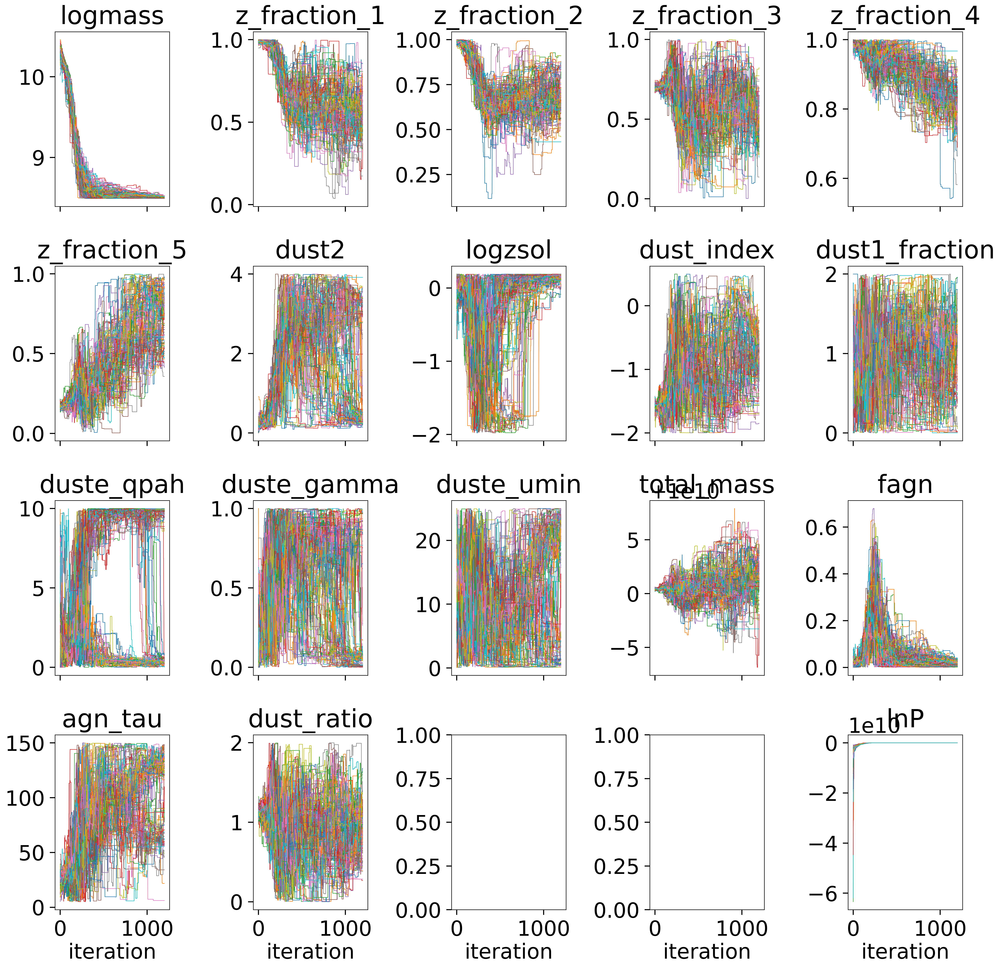

In [29]:
chosen = np.random.choice(G30_EAS04_6_res_prior[0]["run_params"]["nwalkers"], size=100, replace=False)
tracefig = reader.traceplot(G30_EAS04_6_res_prior[0], figsize=(20,20), chains=chosen)

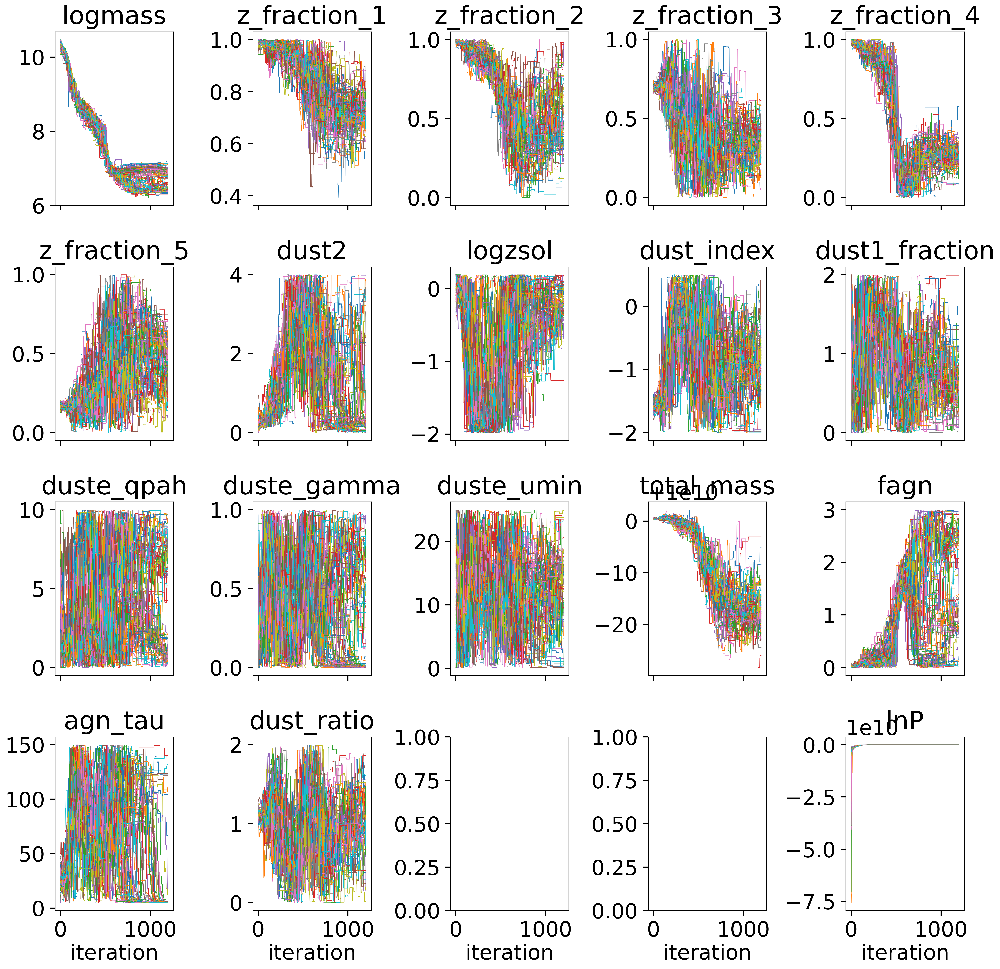

In [11]:
chosen = np.random.choice(G30_EAS04_6_res_no_logmass[0]["run_params"]["nwalkers"], size=100, replace=False)
tracefig = reader.traceplot(G30_EAS04_6_res_no_logmass[0], figsize=(20,20), chains=chosen)

logmass_init: 9.99


/tmp/ipykernel_8857/1142815463.py:16: RuntimeWarning: divide by zero encountered in true_divide
  chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']


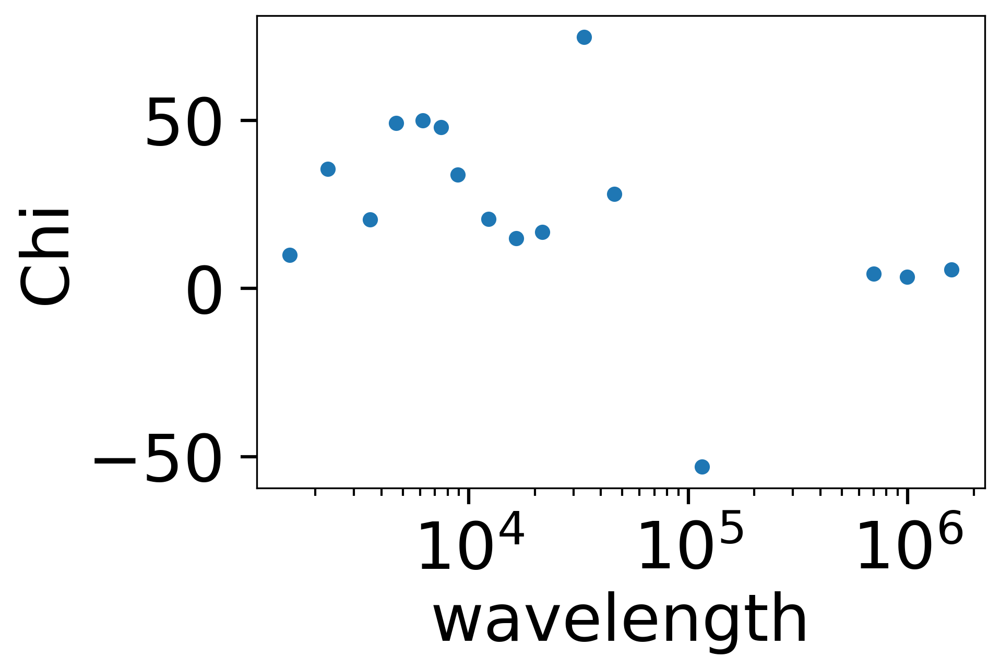

In [12]:
res, obs, model = G30_EAS04_6_res_no_logmass
model = build_model(**res['run_params'])
sps = build_sps(**res['run_params'])


from prospect.plotting.utils import sample_posterior
theta = sample_posterior(res["chain"], weights=res.get("weights", None), nsample=1)[0,:]

# Get the modeled spectra and photometry.
# These have the same shape as the obs['spectrum'] and obs['maggies'] arrays.
spec, phot, mfrac = model.predict(theta, obs=res['obs'], sps=sps)
# mfrac is the ratio of the surviving stellar mass to the formed mass (the ``"mass"`` parameter).

# Plot residuals for this walker and iteration
chifig, chiax = plt.subplots()
chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']
chiax.plot(obs["phot_wave"], chi, 'o')
chiax.set_ylabel("Chi")
chiax.set_xlabel("wavelength")
chiax.set_xscale('log')

logmass_init: 9.99


/tmp/ipykernel_8857/1142815463.py:16: RuntimeWarning: divide by zero encountered in true_divide
  chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']


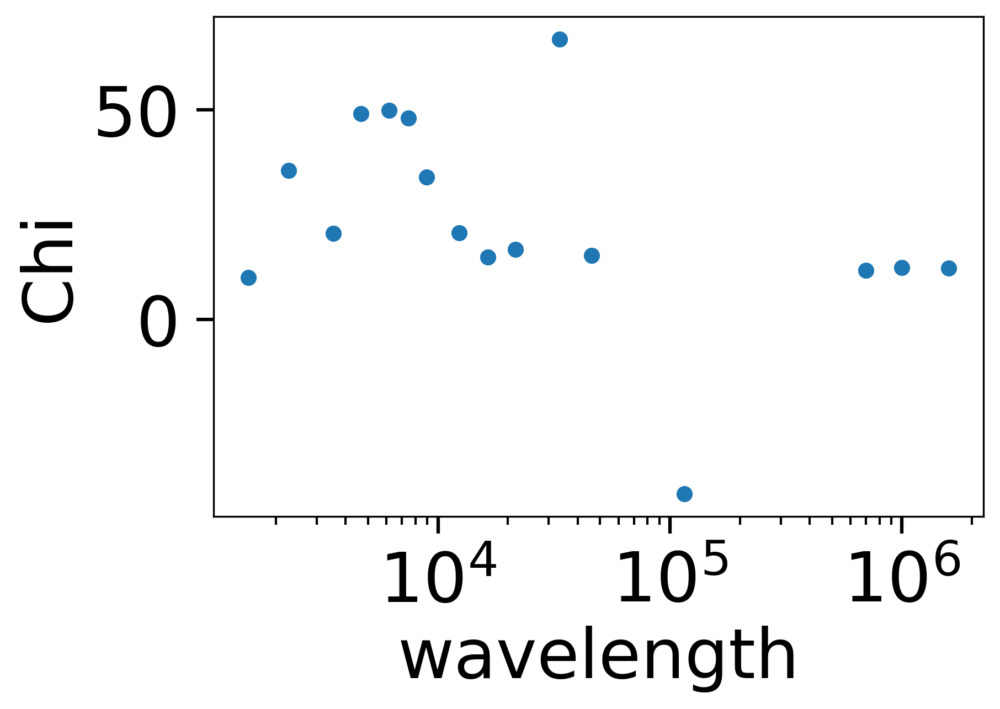

In [13]:
res, obs, model = G30_EAS04_6_res_no_logmass
model = build_model(**res['run_params'])
sps = build_sps(**res['run_params'])


from prospect.plotting.utils import sample_posterior
theta = sample_posterior(res["chain"], weights=res.get("weights", None), nsample=1)[0,:]

# Get the modeled spectra and photometry.
# These have the same shape as the obs['spectrum'] and obs['maggies'] arrays.
spec, phot, mfrac = model.predict(theta, obs=res['obs'], sps=sps)
# mfrac is the ratio of the surviving stellar mass to the formed mass (the ``"mass"`` parameter).

# Plot residuals for this walker and iteration
chifig, chiax = plt.subplots()
chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']
chiax.plot(obs["phot_wave"], chi, 'o')
chiax.set_ylabel("Chi")
chiax.set_xlabel("wavelength")
chiax.set_xscale('log')

In [14]:
output_G10_R6 = reader.results_from('Galaxy_output/CAPS_Output/G10/G10_EAH02_6_res.h5', dangerous = True)
output_G10_R5 = reader.results_from('Galaxy_output/CAPS_Output/G10/G10_EAH02_5.h5', dangerous = True)
output_G10_R7 = reader.results_from('Galaxy_output/CAPS_Output/G10/G10_EAH02_7_res.h5', dangerous = True)

for i in range(0, len(output_G10_R5[0]['bestfit']['parameter'])):
    print(output_G10_R6[0]['theta_labels'][i],'\n\t',
          output_G10_R5[0]['bestfit']['parameter'][i],'\n\t',
          output_G10_R6[0]['bestfit']['parameter'][i],'\n\t',
          output_G10_R7[0]['bestfit']['parameter'][i])

logmass 
	 9.582598019777548 
	 8.263861789477154 
	 8.257812432904657
z_fraction_1 
	 0.6743913048818042 
	 0.9806724608627269 
	 0.8894217667238876
z_fraction_2 
	 0.5705861847354465 
	 0.7919102457917591 
	 0.9536229080898524
z_fraction_3 
	 0.5980833726352346 
	 0.5614068969091399 
	 0.8487207821243068
z_fraction_4 
	 0.5598674818093585 
	 0.7776381621585983 
	 0.8046863641315732
z_fraction_5 
	 0.3870501702323898 
	 0.6890151931313306 
	 0.490884195601728
dust2 
	 0.6300266514987536 
	 0.6279158006902313 
	 0.6161990774731468
logzsol 
	 -1.8727053111796692 
	 -0.6999400616304156 
	 -0.7219387083347975
dust_index 
	 -1.931784449017977 
	 -1.9397716467019364 
	 -1.980116611951195
dust1_fraction 
	 1.0201790081113624 
	 0.23316488192070997 
	 0.29626206258271526
duste_qpah 
	 0.22596278947709109 
	 0.37612017596848984 
	 0.2010283465636304
duste_gamma 
	 0.00020719224669430857 
	 3.904310672201411e-05 
	 2.0295169129608466e-05
duste_umin 
	 24.933020568224787 
	 24.725681039644545 
	

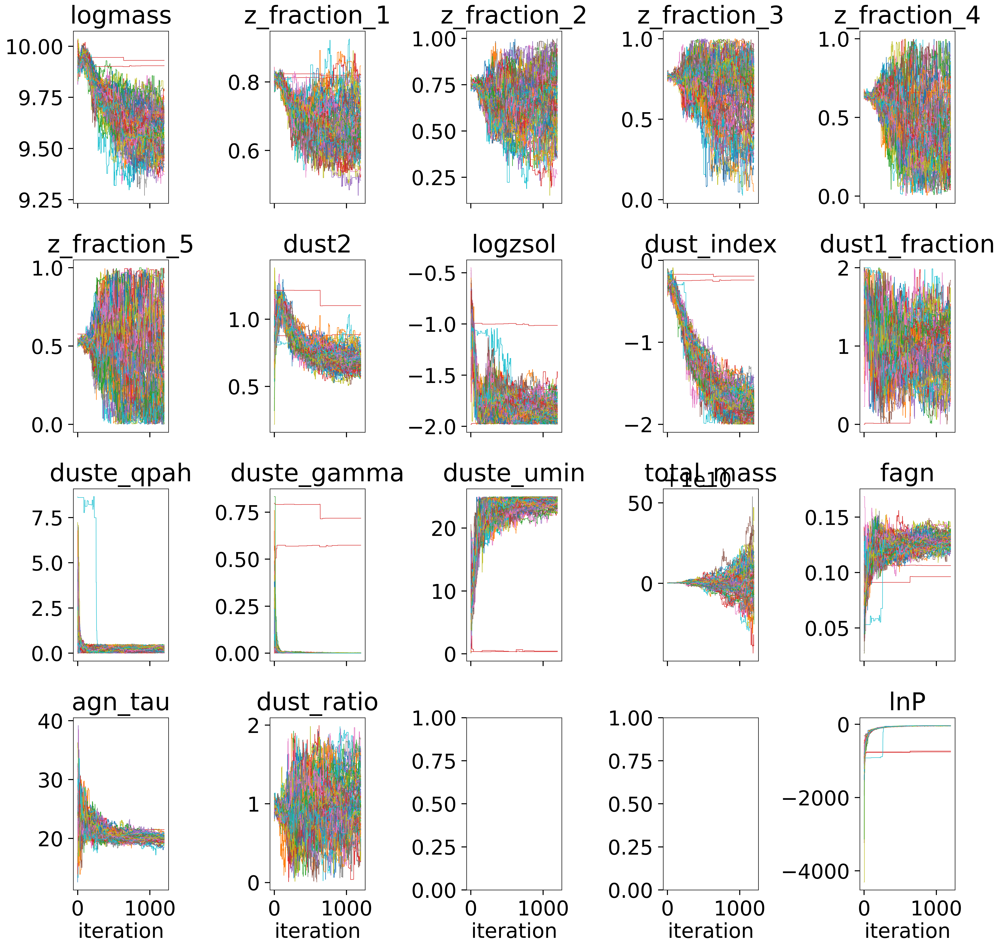

In [15]:
chosen = np.random.choice(output_G10_R5[0]["run_params"]["nwalkers"], size=100, replace=False)
tracefig = reader.traceplot(output_G10_R5[0], figsize=(20,20), chains=chosen)

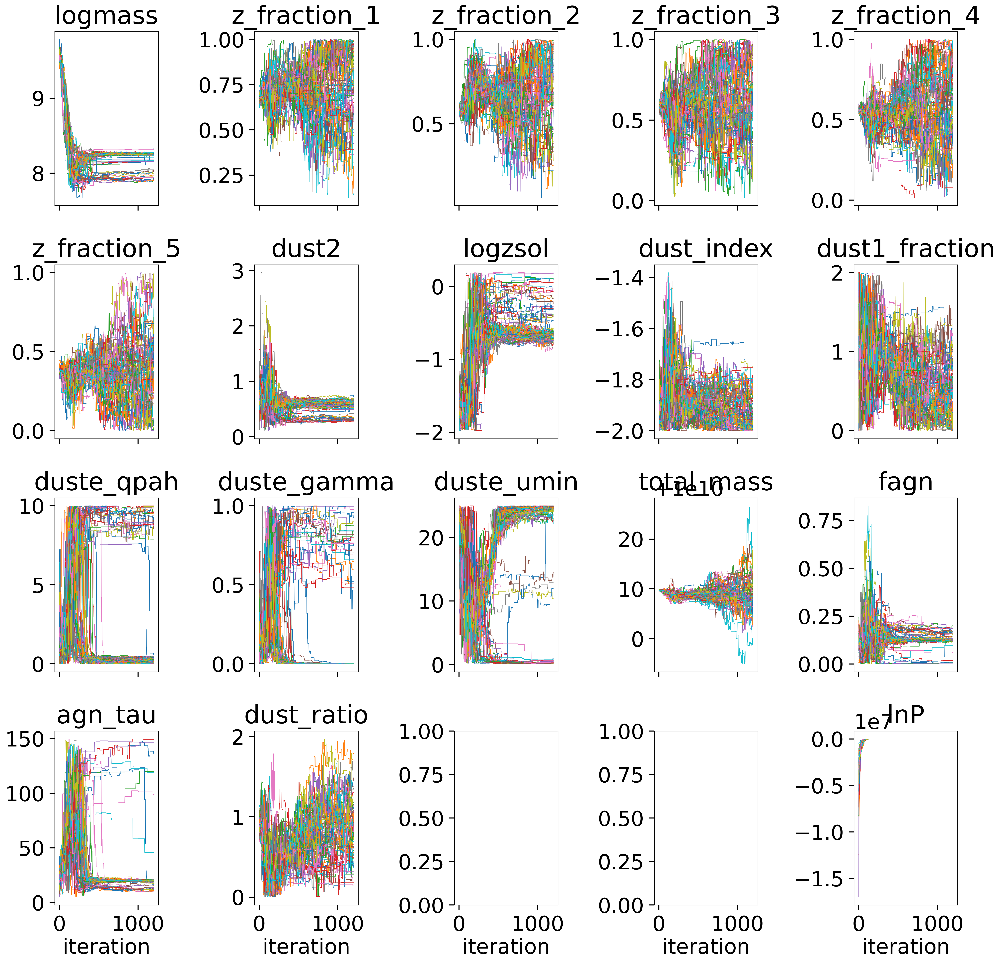

In [16]:
chosen = np.random.choice(output_G10_R6[0]["run_params"]["nwalkers"], size=100, replace=False)
tracefig = reader.traceplot(output_G10_R6[0], figsize=(20,20), chains=chosen)

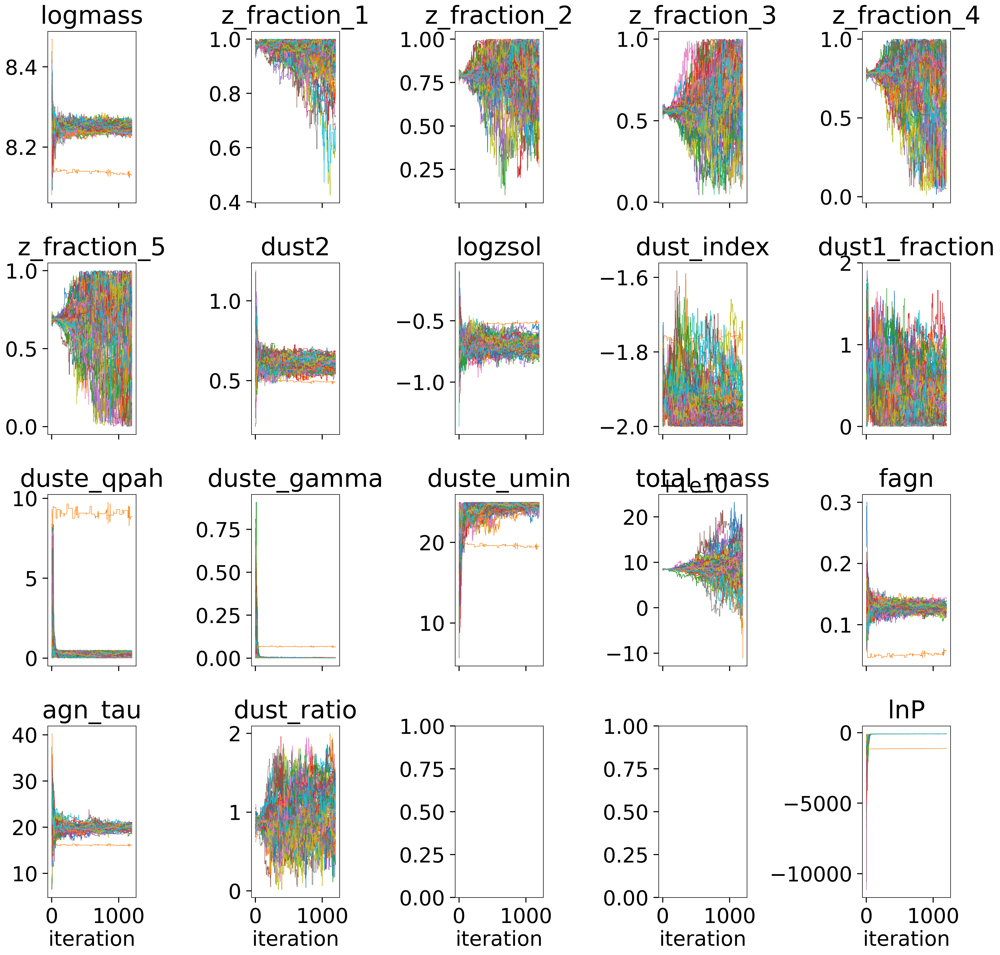

In [17]:
chosen = np.random.choice(output_G10_R7[0]["run_params"]["nwalkers"], size=100, replace=False)
tracefig = reader.traceplot(output_G10_R7[0], figsize=(20,20), chains=chosen)

In [18]:
import matplotlib.pyplot as plt

logmass_init: 10.39


/tmp/ipykernel_8857/1121000973.py:16: RuntimeWarning: divide by zero encountered in true_divide
  chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']


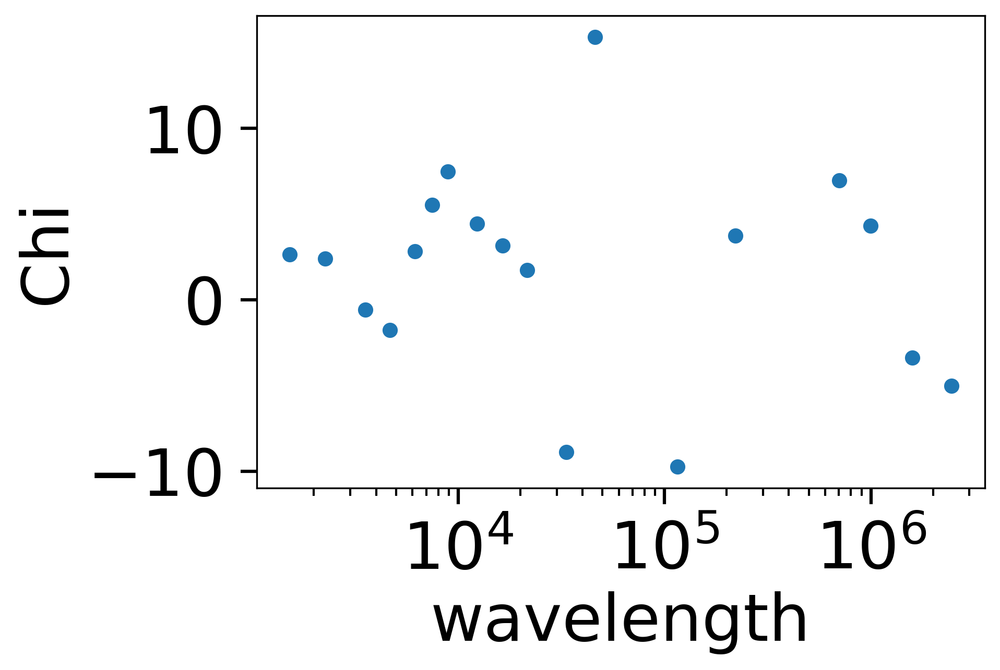

In [19]:
res, obs, model = output_G10_R7
model = build_model(**res['run_params'])
sps = build_sps(**res['run_params'])


from prospect.plotting.utils import sample_posterior
theta = sample_posterior(res["chain"], weights=res.get("weights", None), nsample=1)[0,:]

# Get the modeled spectra and photometry.
# These have the same shape as the obs['spectrum'] and obs['maggies'] arrays.
spec, phot, mfrac = model.predict(theta, obs=res['obs'], sps=sps)
# mfrac is the ratio of the surviving stellar mass to the formed mass (the ``"mass"`` parameter).

# Plot residuals for this walker and iteration
chifig, chiax = plt.subplots()
chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']
chiax.plot(obs["phot_wave"], chi, 'o')
chiax.set_ylabel("Chi")
chiax.set_xlabel("wavelength")
chiax.set_xscale('log')

In [20]:
output = reader.results_from('Galaxy_output/CAPS_Output/G11/G11_EAH03_6_res_22Feb23-02.52.h5', dangerous = True)

In [21]:
output_part2 = reader.results_from('Galaxy_output/CAPS_Output/G11/G11_EAH03_0_res_22Mar07-16.38.h5', dangerous = True)

In [22]:
result= reader.results_from('Galaxy_output/CAPS_Output/G11/G11_EAH03_5.h5', dangerous = True)

In [23]:
output2 = reader.results_from('Galaxy_output/CAPS_Output/G11/G11_EAH03_7_res.h5', dangerous = True)

In [24]:
output3 = reader.results_from('Galaxy_output/CAPS_Output/G11/G11_EAH03_7_res_22Mar01-15.14.h5', dangerous = True)

In [25]:
output_part2[0].keys()

dict_keys(['model_params', 'optimizer_duration', 'paramfile_text', 'run_params', 'acceptance', 'chain', 'initial_theta', 'lnprobability', 'sampling_initial_center', 'rstate', 'sampling_duration', 'theta_labels', 'bestfit', 'optimization', 'obs', 'model'])

In [26]:
output_part2[0]['bestfit']

{}

In [27]:
for i in range(0, len(result[0]['bestfit']['parameter'])):
    print(result[0]['theta_labels'][i],'\n\t',
          result[0]['bestfit']['parameter'][i], '\n\t', 
          output[0]['bestfit']['parameter'][i], '\n\t', 
          output2[0]['bestfit']['parameter'][i],  '\n\t',
          output3[0]['bestfit']['parameter'][i],  '\n\t',
          output_part2[0]['bestfit']['parameter'][i])

KeyError: 'parameter'

In [ ]:
chosen = np.random.choice(result[0]["run_params"]["nwalkers"], size=100, replace=False)
tracefig = reader.traceplot(result[0], figsize=(20,20), chains=chosen)

In [ ]:
chosen = np.random.choice(output[0]["run_params"]["nwalkers"], size=500, replace=False)
tracefig = reader.traceplot(output[0], figsize=(20,20), chains=chosen)

In [ ]:
chosen = np.random.choice(output2[0]["run_params"]["nwalkers"], size=500, replace=False)
tracefig = reader.traceplot(output2[0], figsize=(20,20), chains=chosen)

In [ ]:
chosen = np.random.choice(output3[0]["run_params"]["nwalkers"], size=500, replace=False)
tracefig = reader.traceplot(output3[0], figsize=(20,20), chains=chosen)

In [ ]:
ymin = 1.5 * (10**-9) #* (1/10000)
ymax = 0.0005315684384467088 #* 2.7
xmin = 1222.447801222852 
xmax = 6164346.25 

In [ ]:
res, obs, model = output
model = build_model(**res['run_params'])
sps = build_sps(**res['run_params'])


from prospect.plotting.utils import sample_posterior
theta = sample_posterior(res["chain"], weights=res.get("weights", None), nsample=1)[0,:]

# Get the modeled spectra and photometry.
# These have the same shape as the obs['spectrum'] and obs['maggies'] arrays.
spec, phot, mfrac = model.predict(theta, obs=res['obs'], sps=sps)
# mfrac is the ratio of the surviving stellar mass to the formed mass (the ``"mass"`` parameter).

# Plot residuals for this walker and iteration
chifig, chiax = pl.subplots()
chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']
chiax.plot(wave, chi, 'o')
chiax.set_ylabel("Chi")
chiax.set_xlabel("wavelength")
chiax.set_xscale('log')

In [ ]:
# Generate the model SED at the initial value of theta
theta = model.theta.copy()
initial_spec, initial_phot, initial_mfrac = model.sed(theta, obs=obs, sps=sps)
title_text = ','.join(["{}={}".format(p, model.params[p][0]) 
                       for p in model.free_params])

a = 1.0 + model.params.get('zred', 0.0) # cosmological redshifting
# photometric effective wavelengths
wphot = obs["phot_wave"]
# spectroscopic wavelengths
if obs["wavelength"] is None:
    # *restframe* spectral wavelengths, since obs["wavelength"] is None
    wspec = sps.wavelengths
    wspec *= a #redshift them
else:
    wspec = obs["wavelength"]

# establish bounds
xmin, xmax = np.min(wphot)*0.8, np.max(wphot)/0.8
temp = np.interp(np.linspace(xmin,xmax,10000), wspec, initial_spec)
# ymin, ymax = temp.min()*0.8, temp.max()/0.4
figure(figsize=(16,8))

# plot model + data
loglog(wspec, initial_spec, label='Model spectrum', 
       lw=0.7, color='navy', alpha=0.7)
errorbar(wphot, initial_phot, label='Model photometry', 
         marker='s',markersize=10, alpha=0.8, ls='', lw=3,
         markerfacecolor='none', markeredgecolor='blue', 
         markeredgewidth=3)
errorbar(wphot, obs['maggies'], yerr=obs['maggies_unc'], 
         label='Observed photometry',
         marker='o', markersize=10, alpha=0.8, ls='', lw=3,
         ecolor='red', markerfacecolor='none', markeredgecolor='red', 
         markeredgewidth=3)
# title(title_text)

# plot Filters
for f in obs['filters']:
    w, t = f.wavelength.copy(), f.transmission.copy()
    t = t / t.max()
    t = 10**(0.2*(np.log10(ymax/ymin)))*t * ymin
    loglog(w, t, lw=3, color='gray', alpha=0.7)

# prettify
xlabel('Wavelength [A]')
ylabel('Flux Density [maggies]')
xlim([xmin, xmax])
ylim([ymin, ymax])
legend(loc='best', fontsize=20)
tight_layout()

In [ ]:
res, obs, model = output2
model = build_model(**res['run_params'])
sps = build_sps(**res['run_params'])


from prospect.plotting.utils import sample_posterior
theta = sample_posterior(res["chain"], weights=res.get("weights", None), nsample=1)[0,:]

# Get the modeled spectra and photometry.
# These have the same shape as the obs['spectrum'] and obs['maggies'] arrays.
spec, phot, mfrac = model.predict(theta, obs=res['obs'], sps=sps)
# mfrac is the ratio of the surviving stellar mass to the formed mass (the ``"mass"`` parameter).

# Plot residuals for this walker and iteration
chifig, chiax = pl.subplots()
chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']
chiax.plot(wave, chi, 'o')
chiax.set_ylabel("Chi")
chiax.set_xlabel("wavelength")
chiax.set_xscale('log')

In [ ]:
# Generate the model SED at the initial value of theta
theta = model.theta.copy()
initial_spec, initial_phot, initial_mfrac = model.sed(theta, obs=obs, sps=sps)
title_text = ','.join(["{}={}".format(p, model.params[p][0]) 
                       for p in model.free_params])

a = 1.0 + model.params.get('zred', 0.0) # cosmological redshifting
# photometric effective wavelengths
wphot = obs["phot_wave"]
# spectroscopic wavelengths
if obs["wavelength"] is None:
    # *restframe* spectral wavelengths, since obs["wavelength"] is None
    wspec = sps.wavelengths
    wspec *= a #redshift them
else:
    wspec = obs["wavelength"]

# establish bounds
xmin, xmax = np.min(wphot)*0.8, np.max(wphot)/0.8
temp = np.interp(np.linspace(xmin,xmax,10000), wspec, initial_spec)
# ymin, ymax = temp.min()*0.8, temp.max()/0.4
figure(figsize=(16,8))

# plot model + data
loglog(wspec, initial_spec, label='Model spectrum', 
       lw=0.7, color='navy', alpha=0.7)
errorbar(wphot, initial_phot, label='Model photometry', 
         marker='s',markersize=10, alpha=0.8, ls='', lw=3,
         markerfacecolor='none', markeredgecolor='blue', 
         markeredgewidth=3)
errorbar(wphot, obs['maggies'], yerr=obs['maggies_unc'], 
         label='Observed photometry',
         marker='o', markersize=10, alpha=0.8, ls='', lw=3,
         ecolor='red', markerfacecolor='none', markeredgecolor='red', 
         markeredgewidth=3)
# title(title_text)

# plot Filters
for f in obs['filters']:
    w, t = f.wavelength.copy(), f.transmission.copy()
    t = t / t.max()
    t = 10**(0.2*(np.log10(ymax/ymin)))*t * ymin
    loglog(w, t, lw=3, color='gray', alpha=0.7)

# prettify
xlabel('Wavelength [A]')
ylabel('Flux Density [maggies]')
xlim([xmin, xmax])
ylim([ymin, ymax])
legend(loc='best', fontsize=20)
tight_layout()

In [ ]:
res, obs, model = output3
model = build_model(**res['run_params'])
sps = build_sps(**res['run_params'])


from prospect.plotting.utils import sample_posterior
theta = sample_posterior(res["chain"], weights=res.get("weights", None), nsample=1)[0,:]

# Get the modeled spectra and photometry.
# These have the same shape as the obs['spectrum'] and obs['maggies'] arrays.
spec, phot, mfrac = model.predict(theta, obs=res['obs'], sps=sps)
# mfrac is the ratio of the surviving stellar mass to the formed mass (the ``"mass"`` parameter).

# Plot residuals for this walker and iteration
chifig, chiax = pl.subplots()
chi = (res['obs']['maggies'] - phot) / res['obs']['maggies_unc']
chiax.plot(wave, chi, 'o')
chiax.set_ylabel("Chi")
chiax.set_xlabel("wavelength")
chiax.set_xscale('log')

In [ ]:
# Generate the model SED at the initial value of theta
theta = model.theta.copy()
initial_spec, initial_phot, initial_mfrac = model.sed(theta, obs=obs, sps=sps)
title_text = ','.join(["{}={}".format(p, model.params[p][0]) 
                       for p in model.free_params])

a = 1.0 + model.params.get('zred', 0.0) # cosmological redshifting
# photometric effective wavelengths
wphot = obs["phot_wave"]
# spectroscopic wavelengths
if obs["wavelength"] is None:
    # *restframe* spectral wavelengths, since obs["wavelength"] is None
    wspec = sps.wavelengths
    wspec *= a #redshift them
else:
    wspec = obs["wavelength"]

# establish bounds
xmin, xmax = np.min(wphot)*0.8, np.max(wphot)/0.8
temp = np.interp(np.linspace(xmin,xmax,10000), wspec, initial_spec)
# ymin, ymax = temp.min()*0.8, temp.max()/0.4
figure(figsize=(16,8))

# plot model + data
loglog(wspec, initial_spec, label='Model spectrum', 
       lw=0.7, color='navy', alpha=0.7)
errorbar(wphot, initial_phot, label='Model photometry', 
         marker='s',markersize=10, alpha=0.8, ls='', lw=3,
         markerfacecolor='none', markeredgecolor='blue', 
         markeredgewidth=3)
errorbar(wphot, obs['maggies'], yerr=obs['maggies_unc'], 
         label='Observed photometry',
         marker='o', markersize=10, alpha=0.8, ls='', lw=3,
         ecolor='red', markerfacecolor='none', markeredgecolor='red', 
         markeredgewidth=3)
# title(title_text)

# plot Filters
for f in obs['filters']:
    w, t = f.wavelength.copy(), f.transmission.copy()
    t = t / t.max()
    t = 10**(0.2*(np.log10(ymax/ymin)))*t * ymin
    loglog(w, t, lw=3, color='gray', alpha=0.7)

# prettify
xlabel('Wavelength [A]')
ylabel('Flux Density [maggies]')
xlim([xmin, xmax])
ylim([ymin, ymax])
legend(loc='best', fontsize=20)
tight_layout()

In [ ]:
output_part2 = reader.results_from('Galaxy_output/CAPS_Output/G11/G11_EAH03_0_res_22Mar07-16.38.h5', dangerous = True)
